## Sanity Check: autoencoder fitting input latent code 

In [4]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

import numpy as np
import torch
import torch.nn.functional as F
from tqdm.notebook import tqdm, trange

device = torch.device('cuda:3' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)
torch.manual_seed(1984)


from init import get_AEmodel_cfg
from core.models import get_model
category = "mugs"
# category = "kit4cates"
# category = "chairs"
config_Only_model = get_AEmodel_cfg()
ModelClass = get_model(config_Only_model["model"]["model_name"])
model = ModelClass(config_Only_model)
ckpt_path = f"/home/ziran/se3/EFEM/weights/{category}.pt"
ckpt = torch.load(ckpt_path)
model.network.load_state_dict(ckpt['model_state_dict'])
model.network = model.network.to(device)

bs = 1


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Using device: cuda:3


In [3]:
# # 读取文件
# data = np.loadtxt('./dev_utils/test.sdf')

# # 分离点云位置和SDF值
# points = data[:, :3]  # 取前三列为点云位置
# sdf_values = data[:, 3]  # 取第四列为SDF值

# # 检查结果
# print("Points shape:", points.shape)
# print("SDF Values shape:", sdf_values.shape)

# query = torch.from_numpy(points).unsqueeze(0).repeat(bs, 1, 1).to(device=device, dtype=torch.float32)
# sdf_values = torch.from_numpy(sdf_values).unsqueeze(0).repeat(bs, 1).to(device=device, dtype=torch.float32)
# query_mask = torch.ones(query.shape[:2]).bool()
# print("query max,min: ",query.max(), query.min())
# print("query_sdf max,min: ",sdf_values.max(), sdf_values.min())
# query.shape, query_mask.shape, sdf_values.shape

In [4]:
import pickle
with open(f'./dev_utils/test.sdf', 'rb') as f:
    result = pickle.load(f)
# 分离点云位置和SDF值
points = result['sdf'][:, :3]  # 取前三列为点云位置
sdf_values = result['sdf'][:, 3]  # 取第四列为SDF值
normals = result['normals']
# 检查结果
print("Points shape:", points.shape)
print("SDF Values shape:", sdf_values.shape)
print("Normals shape:", normals.shape)

query = torch.from_numpy(points).unsqueeze(0).repeat(bs, 1, 1).to(device=device, dtype=torch.float32)
sdf_values = torch.from_numpy(sdf_values).unsqueeze(0).repeat(bs, 1).to(device=device, dtype=torch.float32)
query_mask = torch.ones(query.shape[:2]).bool()
normals = torch.from_numpy(normals).unsqueeze(0).repeat(bs, 1, 1).to(device=device, dtype=torch.float32)
print("query max,min: ",query.max(), query.min())
print("query_sdf max,min: ",sdf_values.max(), sdf_values.min())
query.shape, query_mask.shape, sdf_values.shape

Points shape: (10010, 3)
SDF Values shape: (10010,)
Normals shape: (10010, 3)
query max,min:  tensor(0.3585, device='cuda:3') tensor(-0.3551, device='cuda:3')
query_sdf max,min:  tensor(0., device='cuda:3') tensor(0., device='cuda:3')


(torch.Size([1, 10010, 3]), torch.Size([1, 10010]), torch.Size([1, 10010]))

In [5]:
model.network.requires_grad_(True)

def clamp(x, sigma):
    return torch.clamp(x, -sigma, sigma)

SIGMA = 0.1

loss_l1 = torch.nn.L1Loss()
loss_mse = torch.nn.MSELoss()

pred_scale = (torch.ones(bs) + 0.2).to(device)
pred_center = torch.zeros(bs, 1, 3).to(device)

def compute_normals_from_sdf(sdf, query_points):
    # Assumes sdf and query_points are PyTorch tensors
    # sdf: [B, N] - SDF values at query points
    # query_points: [B, N, 3] - Query points (x, y, z)

    # Enable gradient computation for query points
    # query_points.requires_grad_(True)

    # Compute the gradient for the entire batch at once
    grad_outputs = torch.ones_like(sdf, device=device)
    gradients = torch.autograd.grad(outputs=sdf, inputs=query_points,
                                    grad_outputs=grad_outputs,
                                    create_graph=True, retain_graph=True, only_inputs=True)[0]

    # Normalize the gradients to get unit normals
    normals = torch.nn.functional.normalize(gradients, p=2, dim=2)

    return normals

def normal_vector_loss(pred_normals, gt_normals):
    # Calculate the loss between predicted normals and ground truth normals
    # This could be as simple as a mean squared error, or a more complex angular loss
    loss = torch.mean((pred_normals - gt_normals) ** 2)
    return loss


lambda_nv = 0.5
def get_recon_score(x, query, query_mask, sdf_gt = None):
    # model.network.zero_grad()
    # x = x.detach().requires_grad_(True)
    query.requires_grad_(True)
    pred_so3_feat, pred_inv_feat = x[:,:,:3], x[:,:,3]
    
    embedding = {
        "z_so3": pred_so3_feat, # [B, 256, 3]
        "z_inv": pred_inv_feat, # [B, 256]
        "s": pred_scale, # [B]
        "t": pred_center, # [B, 1, 3]
    }

    sdf_hat = model.network.decode(
        query,
        None,
        embedding,
        return_sdf=True,
    )
    if sdf_gt is None:
        sdf_gt = torch.zeros_like(query_mask, device=device, dtype=torch.float32)
        
    # # Calculate predicted normals from sdf_hat (using automatic differentiation)
    # pred_normals = compute_normals_from_sdf(sdf_hat, query)

    # # Calculate the normal vector loss
    # nv_loss = normal_vector_loss(pred_normals, normals)

    # # Combine with existing loss
    # total_loss = F.mse_loss(sdf_hat, sdf_gt) + lambda_nv * nv_loss
    
    # sdf_hat = clamp(sdf_hat[query_mask], SIGMA)
    sdf_gt = clamp(sdf_gt[query_mask], SIGMA)

    # loss = F.mse_loss(sdf_hat[query_mask], sdf_gt[query_mask], reduction='mean')
    # loss = F.mse_loss(sdf_hat, sdf_gt, reduction='mean')
    # loss = loss_l1(sdf_hat, sdf_gt)
    total_loss = torch.mean(torch.abs(sdf_hat - sdf_gt))
    return total_loss

def get_fixed_query_pc(bs):
    N = 50
    space_dim = [N, N, N]  # 示例为一个50x50x50的网格
    di = 0.5
    x = np.linspace(-di, di, space_dim[0])
    y = np.linspace(-di, di, space_dim[1])
    z = np.linspace(-di, di, space_dim[2])
    X, Y, Z = np.meshgrid(x, y, z, indexing='ij')
    viz_query = np.stack([X.ravel(), Y.ravel(), Z.ravel()], axis=-1)
    viz_query = torch.tensor(viz_query,dtype=torch.float32).to(device)
    viz_query = viz_query.repeat(bs, 1, 1)
    return viz_query
fixed_query_pc = get_fixed_query_pc(bs)

def get_feature_recon_AEloss(x, x_gt, fixed_pc=True):
    with torch.no_grad():
        if fixed_pc:
            viz_query = fixed_query_pc
        else:
            viz_query = torch.rand(bs, 50*50*50,3).to(device) - 0.5
        pred_so3_feat, pred_inv_feat = x_gt[:,:,:3].detach(), x_gt[:,:,3].detach()
        embedding = {
            "z_so3": pred_so3_feat, # [B, 256, 3]
            "z_inv": pred_inv_feat, # [B, 256]
            "s": pred_scale, # [B]
            "t": pred_center, # [B, 1, 3]
        }
        sdf_gt = model.network.decode(viz_query, None, embedding, return_sdf=True)        
        
    with torch.enable_grad():
        pred_so3_feat, pred_inv_feat = x[:,:,:3], x[:,:,3]
        embedding = {
            "z_so3": pred_so3_feat, # [B, 256, 3]
            "z_inv": pred_inv_feat, # [B, 256]
            "s": pred_scale, # [B]
            "t": pred_center, # [B, 1, 3]
        }
        sdf_hat = model.network.decode(viz_query, None, embedding, return_sdf=True)        

        # loss = F.mse_loss(sdf_hat[query_mask], sdf_gt[query_mask], reduction='mean')
        # sdf_hat = clamp(sdf_hat[query_mask], SIGMA)
        # sdf_gt = clamp(sdf_gt[query_mask], SIGMA)
        loss = loss_l1(sdf_hat, sdf_gt)

        return loss

In [7]:
from ddpm import LatentDiffusionModel, CustomDataset, get_ddpm_scheduler_variables, extract
codebook_path = f"/home/ziran/se3/EFEM/cache/mugs.npz"
train_ds = CustomDataset(codebook_path)

codebook_x = torch.stack([train_ds[idx][0] for idx in range(len(train_ds))], dim=0)

codebook_x_mean = codebook_x.mean(dim=(0, 1)).to(device)
codebook_x_std = codebook_x.std(dim=(0, 1)).to(device)
print(codebook_x_mean.shape, codebook_x_std.shape)
print(codebook_x_mean, codebook_x_std)

z_so3 (149, 256, 3)
z_inv (149, 256)
center (149, 1, 3)
scale (149,)
z_so3_proj (149, 256, 3)
z_so3_basis (149, 3, 3)
z_so3_var (149, 3)
bbox (149, 3)
bbox_c (149, 3)
pcl (149, 5000, 3)
cls (149,)
torch.Size([4]) torch.Size([4])
tensor([ 9.5219e-03,  2.1677e-03, -4.0071e-05, -5.7096e-04], device='cuda:3') tensor([0.0322, 0.0517, 0.0097, 0.0132], device='cuda:3')


In [7]:
@torch.no_grad()
def eval_code(x, x_gt):
    x = x.detach()
    x_gt = x_gt.detach()
    return torch.mean(torch.abs(x - x_gt))

In [20]:
sdf_values.shape

torch.Size([1, 10010])

In [ ]:
import matplotlib.pyplot as plt
from torch.optim.lr_scheduler import CosineAnnealingLR


# y = torch.rand(bs, 256, 4, device=device) - 0.5
# y = y.clone().detach().requires_grad_(True)  # 这使 y 成为一个叶子节点
x = torch.zeros(bs, 256, 4, requires_grad=True, device=device)
# x = torch.rand(bs, 256, 4, requires_grad=True, device=device)
opt_steps = 50000

decoder_params = model.network.network_dict["decoder"].parameters()
optimizer = torch.optim.Adam([x]+ list(decoder_params), lr=5e-3)
# optimizer = torch.optim.Adam([x], lr=1e-3)
scheduler = CosineAnnealingLR(optimizer, T_max=opt_steps, eta_min=0)

# 初始化一个用于存储损失值的列表
loss_values = []
grad_x_values = []
x_values = []
x_gt = train_ds[0][0].unsqueeze(0).repeat(bs, 1, 1).to(device)
# code_dist = eval_code(x, x_gt)
print("x_gt max,min: ",x_gt.max(), x_gt.min())
# print("code dist: ", code_dist)
for i in range(opt_steps):
    # x = y * codebook_x_std + codebook_x_mean
    optimizer.zero_grad()
    loss = get_recon_score(x, query, query_mask, sdf_values)
    
    # loss = get_feature_recon_AEloss(x, x_gt, fixed_pc=False)
    loss.backward()
    optimizer.step()
    scheduler.step() 
    # 记录损失值
    # code_dist = eval_code(x, x_gt).item()
    loss_item = loss.item()
    grad_x_item = x.grad.detach().abs().mean().item()
    loss_values.append(loss_item)
    grad_x_values.append(grad_x_item)

    # print(f"code dist {i}:", code_dist)
    if i % 100 == 0:
        # print(f"code dist {i}:", code_dist)
        print(f"i {i}:", loss_item)
        print(f"grad_x abs mean {i}:", grad_x_item)
    if (i+1) % 1000 == 0:
        x_values.append(x.detach().cpu().numpy())


import pickle

# 保存到文件
with open('x_values.pkl', 'wb') as f:
    pickle.dump(x_values, f)

In [12]:
len(x_values)
x_values[0]

array([[[ 0.01955629, -0.01673049, -0.0192036 ,  0.02725691],
        [ 0.02107514, -0.01659881, -0.00070897, -0.01716908],
        [ 0.0168383 , -0.01083304, -0.02309892,  0.01917026],
        ...,
        [ 0.0145994 , -0.00995625, -0.01325762, -0.01577035],
        [ 0.01511509, -0.01126353,  0.0061972 , -0.01853809],
        [ 0.00859348, -0.0031872 ,  0.017449  , -0.01527316]]],
      dtype=float32)

In [ ]:

# 绘制损失曲线
plt.plot(loss_values)
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.title('Loss Curve')
plt.show()


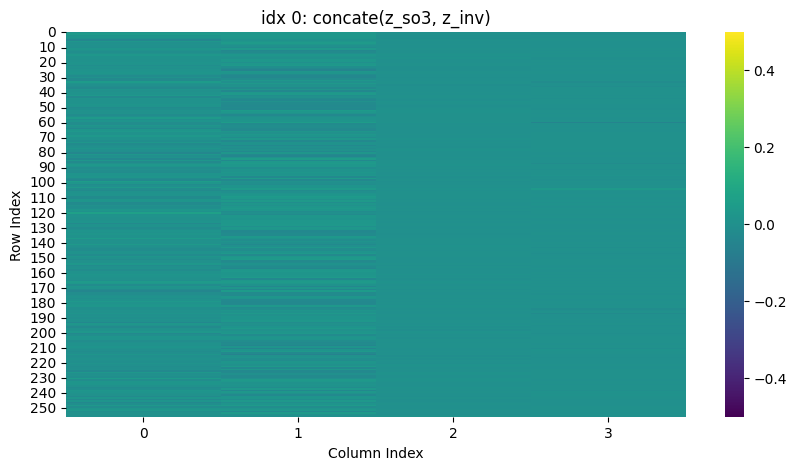

In [1]:
import pickle
# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step200k_lr5e-4_cos_points30k/x_values.pkl" # cos. l1
# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step200k_lr5e-4_cos_points30k_lmse/x_values.pkl" # cos lmse
# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step200k_lr5e-4_points30k_l1/x_values.pkl" # NOcos l1
# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step200k_cos_lr5e-4_points10k_l1_grad/x_values.pkl"
# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step20k_cos_lr5e-7_AEloss_l1_rightquery/x_values.pkl"
# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step20k_cos_lr5e-4_AEloss_l1_rand0.5_rightquery/x_values.pkl"
# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step200k_cos_lr5e-4_Decoder_AEloss_l1_rightquery/x_values.pkl"
# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step10k_cos_lr5e-4_l1_gtclamp_randquery_normto1/x_values.pkl"
# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step10k_cos_lr5e-4_DecoderSepelr-4_l1_gtclamp_randquery_normto1/x_values.pkl"
# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step10k_cos_lr5e-4_DecoderSepelr-4_l1_gtclamp_fixedquery_normto1/x_values.pkl"


# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step100k_cos_lr5e-4_DecoderSepelr-4_l1_gtclamp_randquery_normto1/x_values.pkl"
file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step100k_cos_lr5e-4_DecoderSepelr-4_l1_gtclamp_fixedquery_normto1/x_values.pkl"
# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step100k_cos_lr5e-4_DecoderSepelr-6_l1_gtclamp_randquery_normto1/x_values.pkl"
# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step100k_cos_lr5e-4_DecoderSepelr-6_l1_gtclamp_fixedquery_normto1/x_values.pkl"
# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step100k_cos_lr5e-4_DecoderSepelr-4_l1_gtclamp_pointcloud_NOnormto1/x_values.pkl"
# file_path = "/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step100k_cos_lr5e-4_DecoderSepelr-4_l1_gtclamp_pointcloud_normto1/x_values.pkl"
with open(file_path, "rb") as f:
    x_values = pickle.load(f)

    
len(x_values)


from viz_x import viz_code

viz_code(x_values[-1:])

'/home/ziran/se3/EFEM/lib_shape_prior/sanity_AE_step100k_cos_lr5e-4_DecoderSepelr-4_l1_gtclamp_fixedquery_normto1'

In [19]:
model_ckpt_path = file_path.rpartition('/')[0] + "/model_state_dict.pth"
model.network.load_state_dict(torch.load(model_ckpt_path))

<All keys matched successfully>

In [3]:
import torch
from viz_x import viz_x, viz_pc
viz_x(torch.concat([torch.tensor(x_values[idx])for idx in range(len(x_values))], dim=0)[-1:, :,:] , model, device)


shape:  torch.Size([1, 256, 3]) torch.Size([1, 256]) torch.Size([1]) torch.Size([1, 1, 3])


Max: 0.5738075 Min -0.0071478263


## 可视化codebook中的code, 以及旋转后

In [8]:

from viz_x import rotation_matrices
axis = [[0, 0, 1]]*5  # Example axis
theta = list(range(30, 180,30)) # Example angle in degrees

# Generate the rotation matrix
rot_matrices = rotation_matrices(axis, theta)
rot_matrices = [torch.from_numpy(rot_matrix).to(device) for rot_matrix in rot_matrices]
len(rot_matrices)

5

In [9]:
rot_matrices[2]

tensor([[ 2.2204e-16, -1.0000e+00,  0.0000e+00],
        [ 1.0000e+00,  2.2204e-16,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:3')

In [10]:
for rot_matrix in rot_matrices:
    x = train_ds[1][0].unsqueeze(0).to(device)
    z_so3 = x[:,:,:3]
    z_so3 = z_so3 @ rot_matrix
    z_inv = x[:,:,3:]
    # rot_matrix.dtype
    x = torch.cat([z_so3, z_inv], dim=-1)
    viz_x(x, model, device)

# rot_matrix.dtype


shape:  torch.Size([1, 256, 3]) torch.Size([1, 256]) torch.Size([1]) torch.Size([1, 1, 3])


Max: 0.46737602 Min -0.010565642


shape:  torch.Size([1, 256, 3]) torch.Size([1, 256]) torch.Size([1]) torch.Size([1, 1, 3])


Max: 0.46731243 Min -0.010511469


shape:  torch.Size([1, 256, 3]) torch.Size([1, 256]) torch.Size([1]) torch.Size([1, 1, 3])


Max: 0.4760072 Min -0.010588847


shape:  torch.Size([1, 256, 3]) torch.Size([1, 256]) torch.Size([1]) torch.Size([1, 1, 3])


Max: 0.46737602 Min -0.010565642


shape:  torch.Size([1, 256, 3]) torch.Size([1, 256]) torch.Size([1]) torch.Size([1, 1, 3])


Max: 0.46731243 Min -0.010511469


In [11]:
from viz_x import viz_x, viz_pc
viz_x(torch.concat([z_so3, z_inv], dim=-1), model, device)

shape:  torch.Size([1, 256, 3]) torch.Size([1, 256]) torch.Size([1]) torch.Size([1, 1, 3])


Max: 0.46731243 Min -0.010511469
